<div style="background-color: #013a63; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Module 5 Project - I’m Something of a Painter Myself
</div>

### Monet-style Image Generation with CycleGAN

This project implements a CycleGAN (Cycle-Consistent Generative Adversarial Network) to transform real-world photographs into images that mimic the artistic style of Claude Monet. This is a classic example of an image-to-image translation task.

The goal is to learn a mapping `G: X -> Y`, where `X` is the source domain (photos) and `Y` is the target domain (Monet paintings), without requiring paired training examples.

#### Dataset

The project utilizes the dataset from the Kaggle competition "gan-getting-started". This dataset contains two sets of images:

1.  **Monet Paintings:** A collection of paintings by Claude Monet.
2.  **Photos:** A set of real-world landscape photographs.

The images are provided in both JPG and TFRecord formats.

#### Model Architecture: CycleGAN

A CycleGAN consists of two main components, duplicated for each translation direction:

1.  **Generators:**
    *   `G_XtoY`: Takes a photograph and attempts to generate a Monet-style painting.
    *   `G_YtoX`: Takes a Monet painting and attempts to generate a realistic photograph.
    The notebook explores two different generator architectures: one based on ResNet blocks and another based on a U-Net structure with skip connections.

2.  **Discriminators:**
    *   `D_Y`: Tries to distinguish between real Monet paintings and fake (generated) ones.
    *   `D_X`: Tries to distinguish between real photos and fake (generated) ones.

##### Loss Functions

The model is trained using a combination of losses:

*   **Adversarial Loss:** The standard GAN loss where the generator tries to fool the discriminator, and the discriminator tries to correctly classify real and fake images.
*   **Cycle-Consistency Loss:** This is the key to CycleGAN. It ensures that if you translate an image from domain X to Y and back to X, the result should be close to the original image (`X -> G(X) -> F(G(X)) ≈ X`). This enforces that the generator preserves the underlying content of the image while changing its style.
*   **Identity Loss:** This loss encourages the generator to not alter an image that is already in the target domain. For example, feeding a Monet painting to the photo-to-Monet generator should result in minimal changes.

#### Training and Results

The notebook details the following steps:

1.  **Data Loading and Preprocessing:** Images are loaded, resized to 256x256 pixels, and normalized to a range of `[-1, 1]`.
2.  **Model Compilation:** The CycleGAN model is compiled with Adam optimizers and the combined loss functions.
3.  **Training:** The model is trained for several epochs. During training, a callback periodically saves sample generated images to monitor progress.
4.  **Evaluation:** After training, the model's performance is evaluated by feeding it test photos and visualizing the generated Monet-style images. The results show that the model successfully learns to capture the color palette, brush strokes, and overall aesthetic of Monet's work.
5.  **Submission:** The final part of the notebook generates a set of images for submission to the Kaggle competition.

<div style="background-color: magenta; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Predictive, Exploratory and Analytical Questions
</div>

1. Can the model transform real-world photos into Monet-style paintings?
2. Does the model preserve the content of the original photo while applying Monet's style?
3. How well does the model capture Monet's color palette and brush strokes?
4. Can the model distinguish between Monet paintings and real photos?
5. Does the model avoid altering images that are already in the Monet style?
6. How realistic and convincing are the generated Monet-style images?
7. How consistent are the results when translating images back and forth between domains?
8. What limitations or artifacts are present in the generated images?

<div style="background-color: purple; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Install Dependencies
</div>

<div style="background-color: purple; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Libraries
</div>

In [1]:
from pathlib import Path
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import keras
from keras import layers, ops
import tensorflow_datasets as tfds

tfds.disable_progress_bar()
autotune = tf.data.AUTOTUNE

os.environ["KERAS_BACKEND"] = "tensorflow"

2025-09-05 04:46:27.991953: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1757047588.149364      19 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1757047588.194880      19 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


<div style="background-color: purple; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Dataset Description - Monet Dataset
</div>

### Dataset

The project utilizes the dataset from the Kaggle competition "gan-getting-started". This dataset contains two sets of images:

1.  **Monet Paintings:** A collection of paintings by Claude Monet.
2.  **Photos:** A set of real-world landscape photographs.

The images are provided in both JPG and TFRecord formats.

**Dataset Details:**

- The dataset is organized into three main folders:
    - `monet_jpg`: Contains 1,072 JPEG images of Monet paintings, each sized 256x256 pixels.
    - `photo_jpg`: Contains 6,287 JPEG images of landscape photographs, each sized 256x256 pixels.
    - `test_jpg`: Contains 3,000 JPEG images of landscape photographs (test set), each sized 256x256 pixels. These are used for generating submissions and do not have corresponding Monet images.
- Additionally, the dataset includes TFRecord files for efficient data loading in TensorFlow.
- All images are already resized and cropped to 256x256 pixels, making them ready for training without further preprocessing.
- The dataset is unpaired: there is no direct correspondence between Monet paintings and photos.

**Summary Table:**

| Folder      | Description                  | Number of Images | Image Size |
|-------------|------------------------------|------------------|------------|
| monet_jpg   | Monet paintings              | 1,072            | 256x256    |
| photo_jpg   | Real-world landscape photos  | 6,287            | 256x256    |
| test_jpg    | Test set photos (no labels)  | 3,000            | 256x256    |

<div style="background-color: purple; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Loading the Dataset and Inspection
</div>

### Loading Data

In [2]:
ROOT='/kaggle/input/gan-getting-started'

monet_ds = keras.utils.image_dataset_from_directory(
    ROOT + '/monet_jpg',
    label_mode=None,
    batch_size=1,
    image_size=(256, 256),
)

photo_ds = keras.utils.image_dataset_from_directory(
    ROOT + '/photo_jpg',
    label_mode=None,
    batch_size=1,
    image_size=(256, 256),
)

monet_ds = monet_ds.cache()
photo_ds = photo_ds.cache()
monet_ds = monet_ds.prefetch(tf.data.AUTOTUNE)
photo_ds = photo_ds.prefetch(tf.data.AUTOTUNE)

Found 300 files.


I0000 00:00:1757047602.882389      19 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


Found 7038 files.



<div style="background-color: purple; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Dataset Inspection and Initial Analysis
</div>

In [3]:
def display_samples(ds, row, col):
    ds_iter = iter(ds)
    plt.figure(figsize=(15, int(15*row/col)))
    for j in range(row*col):
        example_sample = next(ds_iter)
        plt.subplot(row,col,j+1)
        plt.axis('off')
        plt.imshow(example_sample.numpy().astype('int32')[0])
    plt.show()

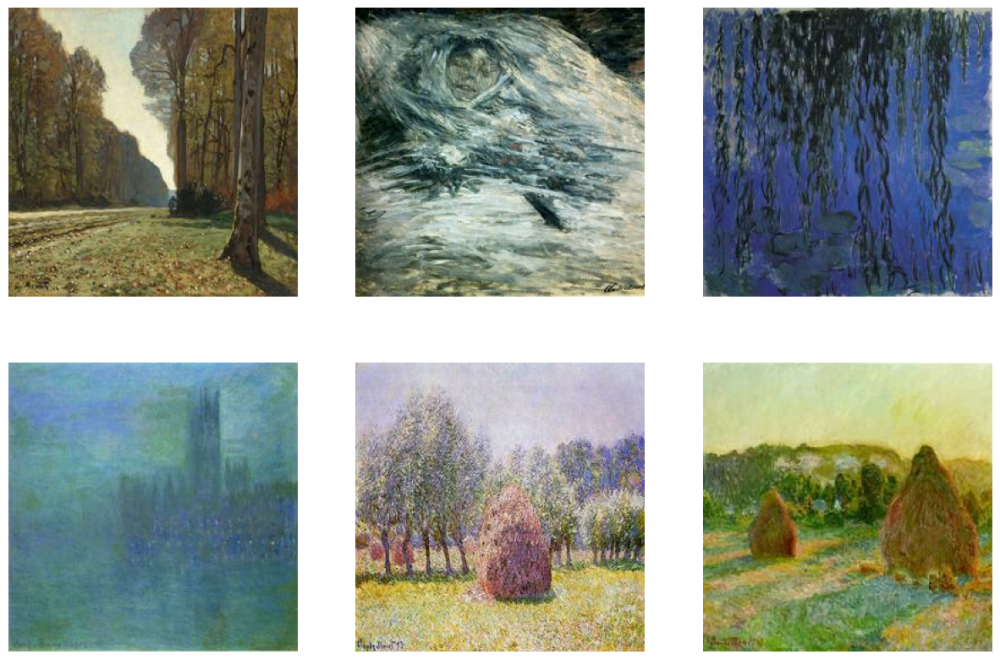

In [4]:
display_samples(monet_ds, 2, 3)

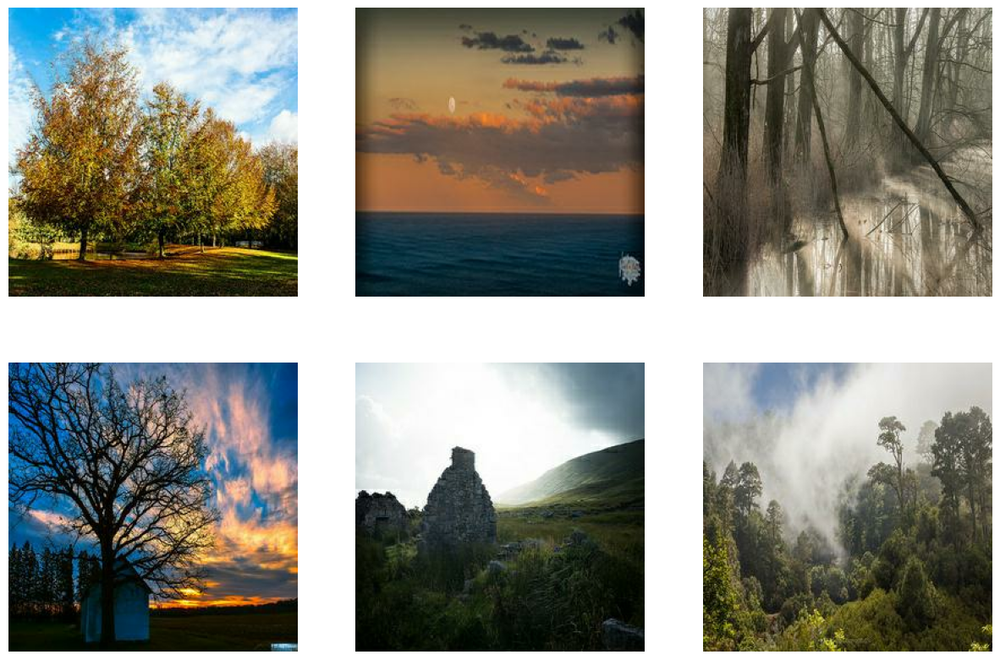

In [5]:
display_samples(photo_ds, 2, 3)

In [6]:
# Monet dataset
print(f'Monet shape: {iter(monet_ds).next().shape}')

# Photo dataset
print(f'Photo shape: {iter(photo_ds).next().shape}')

Monet shape: (1, 256, 256, 3)
Photo shape: (1, 256, 256, 3)


<div style="background-color: purple; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Dataset Preparation
</div>

In [7]:
monet_ds = monet_ds.map(lambda x: (x / 127.5) - 1.0)
photo_ds = photo_ds.map(lambda x: (x / 127.5) - 1.0)

<div style="background-color: purple; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Model Training
</div>

### Basic CycleGAN

### Preparation for the Generator and Discriminator

In [8]:
# Define the standard image size.
orig_img_size = (256, 256)
# Size of the random crops to be used during training.
input_img_size = (256, 256, 3)

# Weights initializer for the layers.
kernel_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# Gamma initializer for instance normalization.
gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

In [9]:
class ReflectionPadding2D(layers.Layer):
    """Implements Reflection Padding as a layer.

    Args:
        padding(tuple): Amount of padding for the
        spatial dimensions.

    Returns:
        A padded tensor with the same type as the input tensor.
    """

    def __init__(self, padding=(1, 1), **kwargs):
        self.padding = tuple(padding)
        super().__init__(**kwargs)

    def call(self, input_tensor, mask=None):
        padding_width, padding_height = self.padding
        padding_tensor = [
            [0, 0],
            [padding_height, padding_height],
            [padding_width, padding_width],
            [0, 0],
        ]
        return ops.pad(input_tensor, padding_tensor, mode="REFLECT")


def residual_block(
    x,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3),
    strides=(1, 1),
    padding="valid",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    dim = x.shape[-1]
    input_tensor = x

    x = ReflectionPadding2D()(input_tensor)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = keras.layers.GroupNormalization(groups=1, gamma_initializer=gamma_initializer)(
        x
    )
    x = activation(x)

    x = ReflectionPadding2D()(x)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = keras.layers.GroupNormalization(groups=1, gamma_initializer=gamma_initializer)(
        x
    )
    x = layers.add([input_tensor, x])
    return x


def downsample(
    x,
    filters,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3),
    strides=(2, 2),
    padding="same",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv2D(
        filters,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = keras.layers.GroupNormalization(groups=1, gamma_initializer=gamma_initializer)(
        x
    )
    if activation:
        x = activation(x)
    return x


def upsample(
    x,
    filters,
    activation,
    kernel_size=(3, 3),
    strides=(2, 2),
    padding="same",
    kernel_initializer=kernel_init,
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv2DTranspose(
        filters,
        kernel_size,
        strides=strides,
        padding=padding,
        kernel_initializer=kernel_initializer,
        use_bias=use_bias,
    )(x)
    x = keras.layers.GroupNormalization(groups=1, gamma_initializer=gamma_initializer)(
        x
    )
    if activation:
        x = activation(x)
    return x

### Build the Generator

The generator consists of downsampling blocks: nine residual blocks and upsampling blocks. The structure of the generator is the following:


c7s1-64 ==> Conv block with `relu` activation, filter size of 7

d128 ====|

         |-> 2 downsampling blocks

d256 ====|

R256 ====|

R256     |

R256     |

R256     |

R256     |-> 9 residual blocks

R256     |

R256     |

R256     |

R256 ====|

u128 ====|

         |-> 2 upsampling blocks

u64  ====|

c7s1-3 => Last conv block with `tanh` activation, filter size of 7.

In [10]:
def get_resnet_generator(
    filters=64,
    num_downsampling_blocks=2,
    num_residual_blocks=9,
    num_upsample_blocks=2,
    gamma_initializer=gamma_init,
    name=None,
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = ReflectionPadding2D(padding=(3, 3))(img_input)
    x = layers.Conv2D(filters, (7, 7), kernel_initializer=kernel_init, use_bias=False)(
        x
    )
    x = keras.layers.GroupNormalization(groups=1, gamma_initializer=gamma_initializer)(
        x
    )
    x = layers.Activation("relu")(x)

    # Downsampling
    for _ in range(num_downsampling_blocks):
        filters *= 2
        x = downsample(x, filters=filters, activation=layers.Activation("relu"))

    # Residual blocks
    for _ in range(num_residual_blocks):
        x = residual_block(x, activation=layers.Activation("relu"))

    # Upsampling
    for _ in range(num_upsample_blocks):
        filters //= 2
        x = upsample(x, filters, activation=layers.Activation("relu"))

    # Final block
    x = ReflectionPadding2D(padding=(3, 3))(x)
    x = layers.Conv2D(3, (7, 7), padding="valid")(x)
    x = layers.Activation("tanh")(x)

    model = keras.models.Model(img_input, x, name=name)
    return model

### Build the Discriminator

The discriminators implement the following architecture: C64->C128->C256->C512

In [11]:
def get_discriminator(
    filters=64, kernel_initializer=kernel_init, num_downsampling=3, name=None
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = layers.Conv2D(
        filters,
        (4, 4),
        strides=(2, 2),
        padding="same",
        kernel_initializer=kernel_initializer,
    )(img_input)
    x = layers.LeakyReLU(0.2)(x)

    num_filters = filters
    for num_downsample_block in range(3):
        num_filters *= 2
        if num_downsample_block < 2:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(2, 2),
            )
        else:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(1, 1),
            )

    x = layers.Conv2D(
        1, (4, 4), strides=(1, 1), padding="same", kernel_initializer=kernel_initializer
    )(x)

    model = keras.models.Model(inputs=img_input, outputs=x, name=name)
    return model


# Get the generators

# Photo to Monet
gen_G = get_resnet_generator(name="generator_G")

# Monet to Photo
gen_F = get_resnet_generator(name="generator_F")

# Get the discriminators


disc_X = get_discriminator(name="discriminator_X")
disc_Y = get_discriminator(name="discriminator_Y")

### Build the CycleGAN Model

We will override the train_step() method of the Model class for training via fit().

In [12]:
class CycleGan(keras.Model):
    def __init__(
        self,
        generator_G,
        generator_F,
        discriminator_X,
        discriminator_Y,
        lambda_cycle=10.0,
        lambda_identity=0.5,
    ):
        super().__init__()
        self.gen_G = generator_G
        self.gen_F = generator_F
        self.disc_X = discriminator_X
        self.disc_Y = discriminator_Y
        self.lambda_cycle = lambda_cycle
        self.lambda_identity = lambda_identity

    def call(self, inputs):
        return (
            self.disc_X(inputs),
            self.disc_Y(inputs),
            self.gen_G(inputs),
            self.gen_F(inputs),
        )

    def compile(
        self,
        gen_G_optimizer,
        gen_F_optimizer,
        disc_X_optimizer,
        disc_Y_optimizer,
        gen_loss_fn,
        disc_loss_fn,
    ):
        super().compile()
        self.gen_G_optimizer = gen_G_optimizer
        self.gen_F_optimizer = gen_F_optimizer
        self.disc_X_optimizer = disc_X_optimizer
        self.disc_Y_optimizer = disc_Y_optimizer
        self.generator_loss_fn = gen_loss_fn
        self.discriminator_loss_fn = disc_loss_fn
        self.cycle_loss_fn = keras.losses.MeanAbsoluteError()
        self.identity_loss_fn = keras.losses.MeanAbsoluteError()

    def train_step(self, batch_data):
        # x is photo and y is monet
        real_x, real_y = batch_data

        # For CycleGAN, we need to calculate different
        # kinds of losses for the generators and discriminators.
        # We will perform the following steps here:
        #
        # 1. Pass real images through the generators and get the generated images
        # 2. Pass the generated images back to the generators to check if we
        #    can predict the original image from the generated image.
        # 3. Do an identity mapping of the real images using the generators.
        # 4. Pass the generated images in 1) to the corresponding discriminators.
        # 5. Calculate the generators total loss (adversarial + cycle + identity)
        # 6. Calculate the discriminators loss
        # 7. Update the weights of the generators
        # 8. Update the weights of the discriminators
        # 9. Return the losses in a dictionary

        with tf.GradientTape(persistent=True) as tape:
            # Photo to fake Monet
            fake_y = self.gen_G(real_x, training=True)
            
            # Monet to fake Photo -> y2x
            fake_x = self.gen_F(real_y, training=True)

            # Cycle (Photo to fake Monet to fake Photo): x -> y -> x
            cycled_x = self.gen_F(fake_y, training=True)

            # Cycle (Monet to fake Photo to fake Monet): y -> x -> y
            cycled_y = self.gen_G(fake_x, training=True)

            # Identity mapping
            same_x = self.gen_F(real_x, training=True)
            same_y = self.gen_G(real_y, training=True)

            # Discriminator output
            disc_real_x = self.disc_X(real_x, training=True)
            disc_fake_x = self.disc_X(fake_x, training=True)

            disc_real_y = self.disc_Y(real_y, training=True)
            disc_fake_y = self.disc_Y(fake_y, training=True)

            # Generator adversarial loss
            gen_G_loss = self.generator_loss_fn(disc_fake_y)
            gen_F_loss = self.generator_loss_fn(disc_fake_x)

            # Generator cycle loss
            cycle_loss_G = self.cycle_loss_fn(real_y, cycled_y) * self.lambda_cycle
            cycle_loss_F = self.cycle_loss_fn(real_x, cycled_x) * self.lambda_cycle

            # Generator identity loss
            id_loss_G = (
                self.identity_loss_fn(real_y, same_y)
                * self.lambda_cycle
                * self.lambda_identity
            )
            id_loss_F = (
                self.identity_loss_fn(real_x, same_x)
                * self.lambda_cycle
                * self.lambda_identity
            )

            # Total generator loss
            total_loss_G = gen_G_loss + cycle_loss_G + id_loss_G
            total_loss_F = gen_F_loss + cycle_loss_F + id_loss_F

            # Discriminator loss
            disc_X_loss = self.discriminator_loss_fn(disc_real_x, disc_fake_x)
            disc_Y_loss = self.discriminator_loss_fn(disc_real_y, disc_fake_y)

        # Get the gradients for the generators
        grads_G = tape.gradient(total_loss_G, self.gen_G.trainable_variables)
        grads_F = tape.gradient(total_loss_F, self.gen_F.trainable_variables)

        # Get the gradients for the discriminators
        disc_X_grads = tape.gradient(disc_X_loss, self.disc_X.trainable_variables)
        disc_Y_grads = tape.gradient(disc_Y_loss, self.disc_Y.trainable_variables)

        # Update the weights of the generators
        self.gen_G_optimizer.apply_gradients(
            zip(grads_G, self.gen_G.trainable_variables)
        )
        self.gen_F_optimizer.apply_gradients(
            zip(grads_F, self.gen_F.trainable_variables)
        )

        # Update the weights of the discriminators
        self.disc_X_optimizer.apply_gradients(
            zip(disc_X_grads, self.disc_X.trainable_variables)
        )
        self.disc_Y_optimizer.apply_gradients(
            zip(disc_Y_grads, self.disc_Y.trainable_variables)
        )

        return {
            "G_loss": total_loss_G,
            "F_loss": total_loss_F,
            "D_X_loss": disc_X_loss,
            "D_Y_loss": disc_Y_loss,
        }

### Create a callback that periodically saves generated images

In [13]:
class GANMonitor(keras.callbacks.Callback):
    """A callback to generate and save images after each epoch"""

    def __init__(self, num_img=4):
        self.num_img = num_img
        self.save_dir = "generated_images"
        os.makedirs(self.save_dir, exist_ok=True)

    def on_epoch_end(self, epoch, logs=None):
        _, ax = plt.subplots(4, 2, figsize=(12, 12))
        for i, img in enumerate(photo_ds.take(self.num_img)):
            prediction = self.model.gen_G(img)[0].numpy()
            prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
            img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

            ax[i, 0].imshow(img)
            ax[i, 1].imshow(prediction)
            ax[i, 0].set_title("Input image")
            ax[i, 1].set_title("Translated image")
            ax[i, 0].axis("off")
            ax[i, 1].axis("off")

            prediction = keras.utils.array_to_img(prediction)
            prediction.save(
                os.path.join(self.save_dir, f"generated_img_{i}_{epoch + 1}.png")
            )
        plt.show()
        plt.close()


### Train the End-to-End Model

Epoch 1/20


I0000 00:00:1757047721.177927      65 service.cc:148] XLA service 0x7fd5ac003320 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1757047721.178541      65 service.cc:156]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1757047732.893178      65 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1757047757.323180      65 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step - D_X_loss: 0.1087 - D_Y_loss: 0.0772 - F_loss: 4.9317 - G_loss: 5.0710

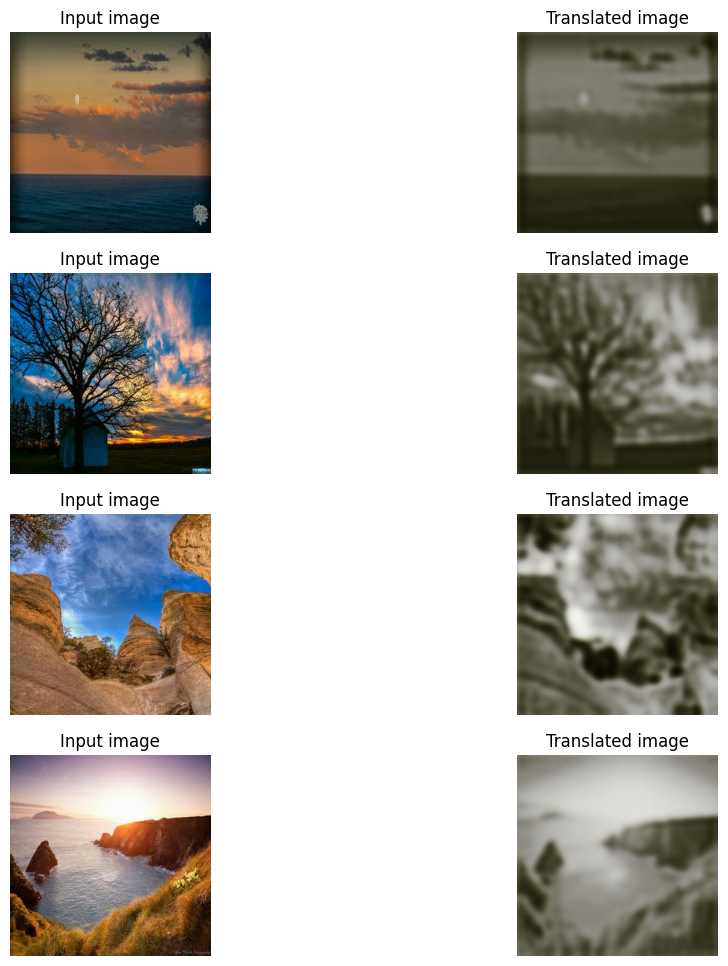

300/300 ━━━━━━━━━━━━━━━━━━━━ 213s 278ms/step - D_X_loss: 0.1087 - D_Y_loss: 0.0770 - F_loss: 4.9298 - G_loss: 5.0672
Epoch 2/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step - D_X_loss: 0.1075 - D_Y_loss: 0.0762 - F_loss: 4.2715 - G_loss: 4.0015

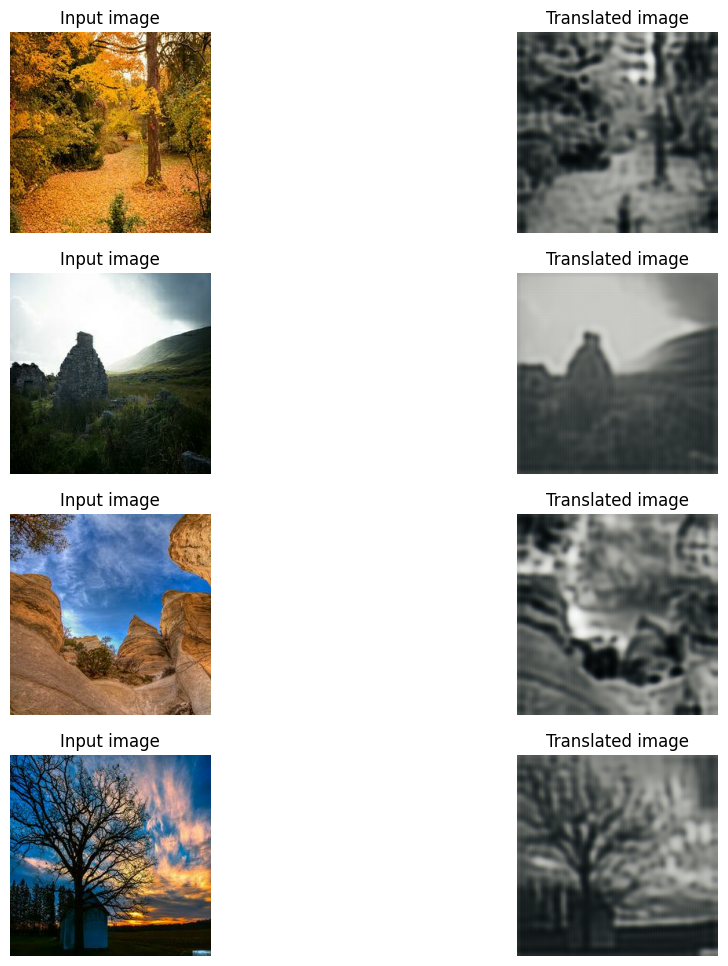

300/300 ━━━━━━━━━━━━━━━━━━━━ 83s 275ms/step - D_X_loss: 0.1072 - D_Y_loss: 0.0767 - F_loss: 4.2726 - G_loss: 3.9995
Epoch 3/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step - D_X_loss: 0.1273 - D_Y_loss: 0.0568 - F_loss: 3.9462 - G_loss: 3.8913

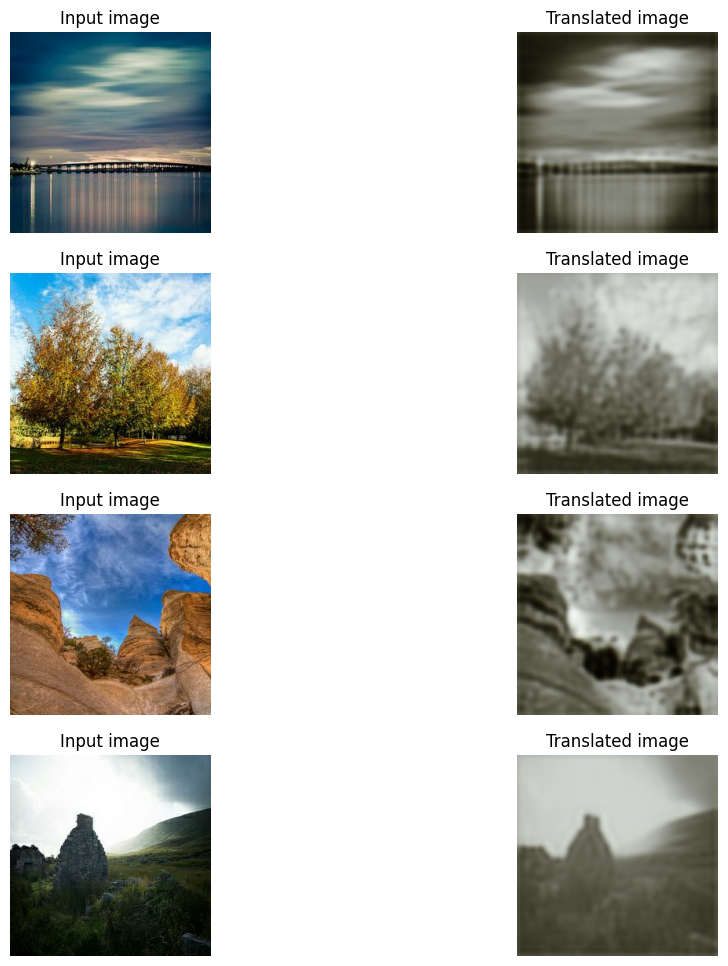

300/300 ━━━━━━━━━━━━━━━━━━━━ 84s 279ms/step - D_X_loss: 0.1271 - D_Y_loss: 0.0568 - F_loss: 3.9440 - G_loss: 3.8903
Epoch 4/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step - D_X_loss: 0.1377 - D_Y_loss: 0.0640 - F_loss: 3.7443 - G_loss: 3.7666

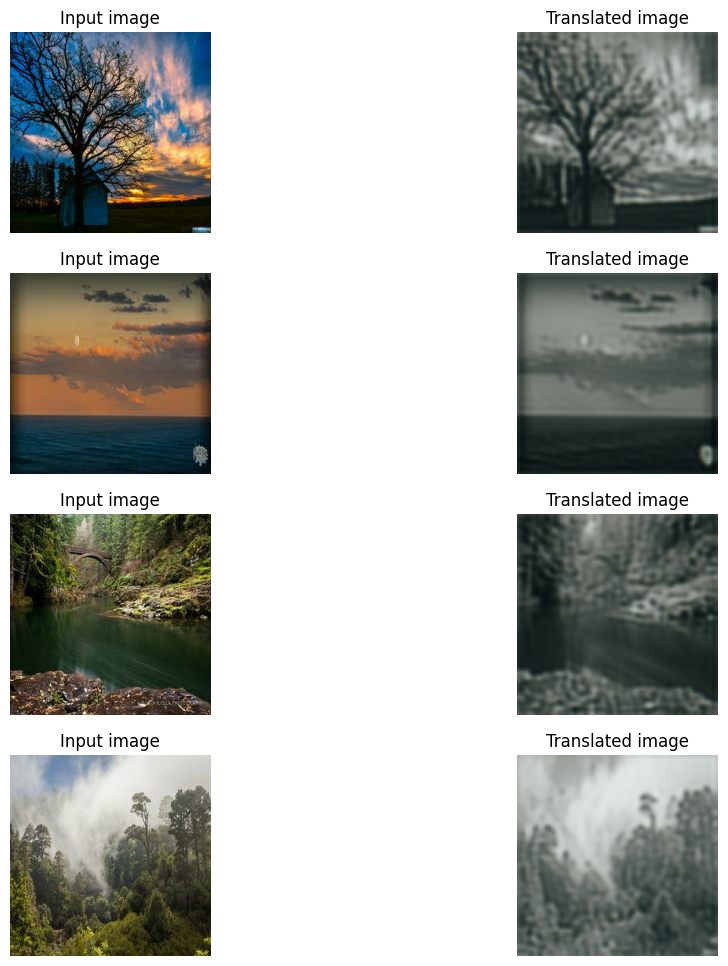

300/300 ━━━━━━━━━━━━━━━━━━━━ 83s 275ms/step - D_X_loss: 0.1373 - D_Y_loss: 0.0639 - F_loss: 3.7425 - G_loss: 3.7664
Epoch 5/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step - D_X_loss: 0.1281 - D_Y_loss: 0.0866 - F_loss: 3.7003 - G_loss: 3.7349

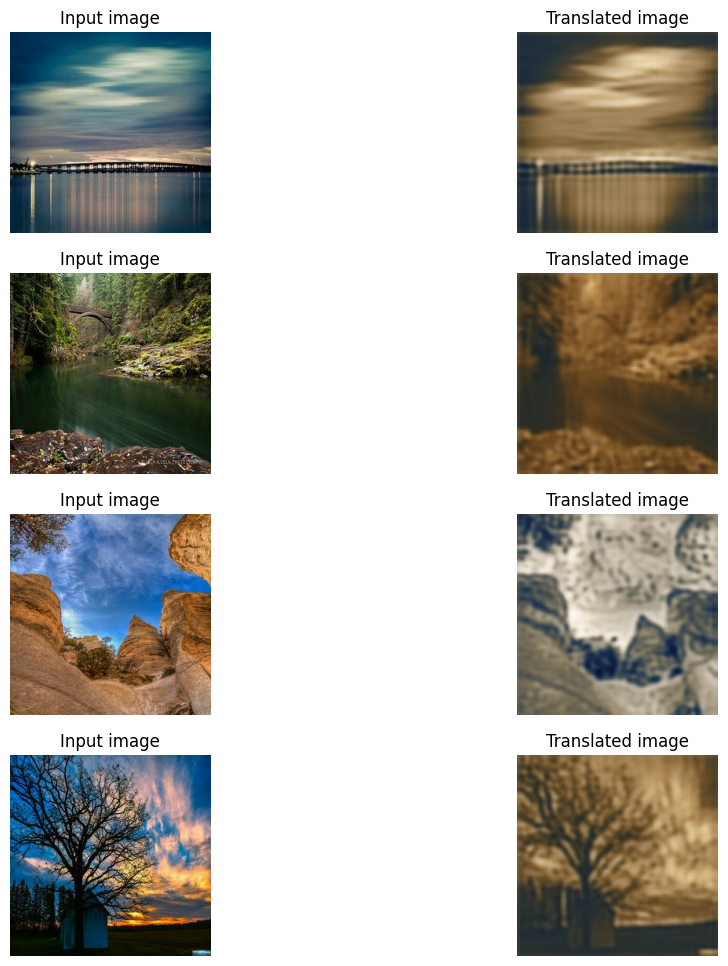

300/300 ━━━━━━━━━━━━━━━━━━━━ 83s 275ms/step - D_X_loss: 0.1283 - D_Y_loss: 0.0868 - F_loss: 3.6981 - G_loss: 3.7334
Epoch 6/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - D_X_loss: 0.1296 - D_Y_loss: 0.1644 - F_loss: 3.8580 - G_loss: 3.6084

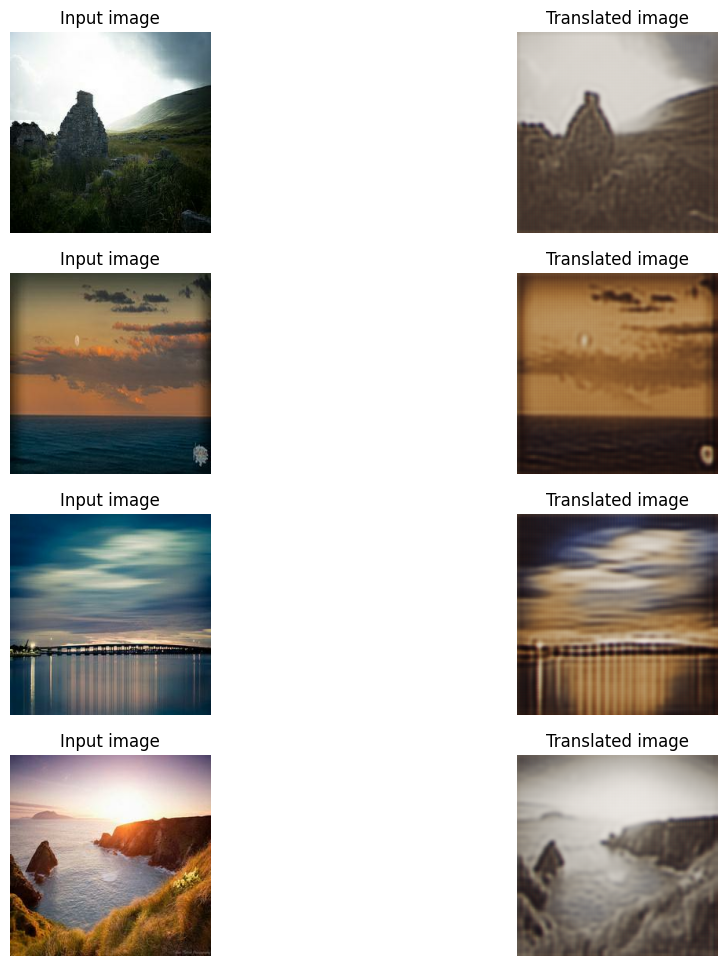

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 275ms/step - D_X_loss: 0.1293 - D_Y_loss: 0.1640 - F_loss: 3.8574 - G_loss: 3.6079
Epoch 7/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - D_X_loss: 0.1650 - D_Y_loss: 0.1346 - F_loss: 3.2548 - G_loss: 3.3206

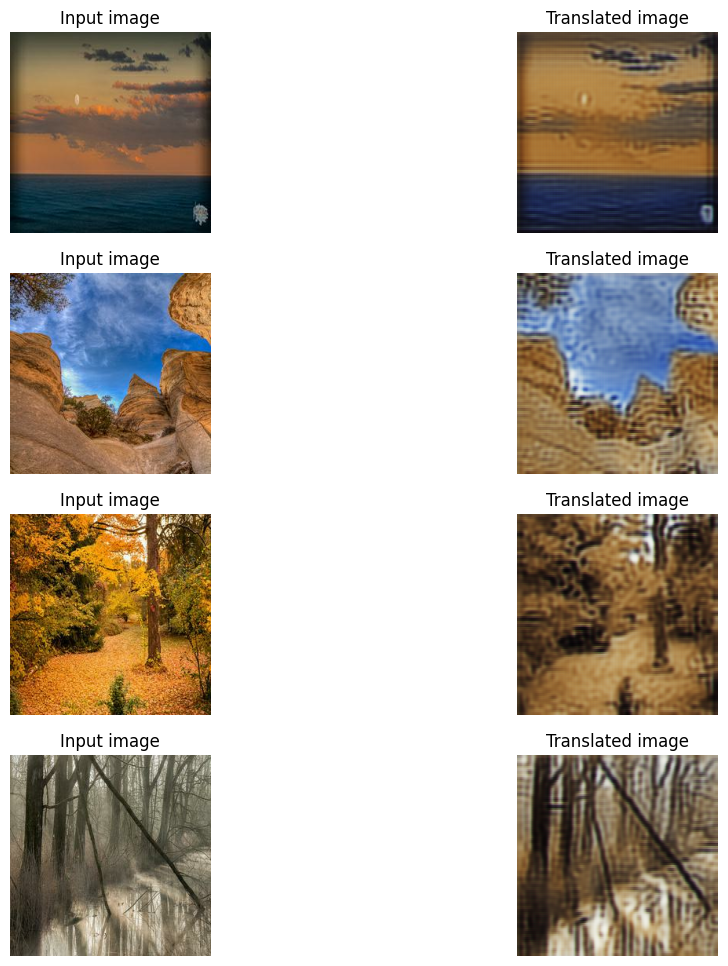

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 274ms/step - D_X_loss: 0.1646 - D_Y_loss: 0.1351 - F_loss: 3.2567 - G_loss: 3.3187
Epoch 8/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - D_X_loss: 0.1302 - D_Y_loss: 0.1339 - F_loss: 3.0825 - G_loss: 3.1058

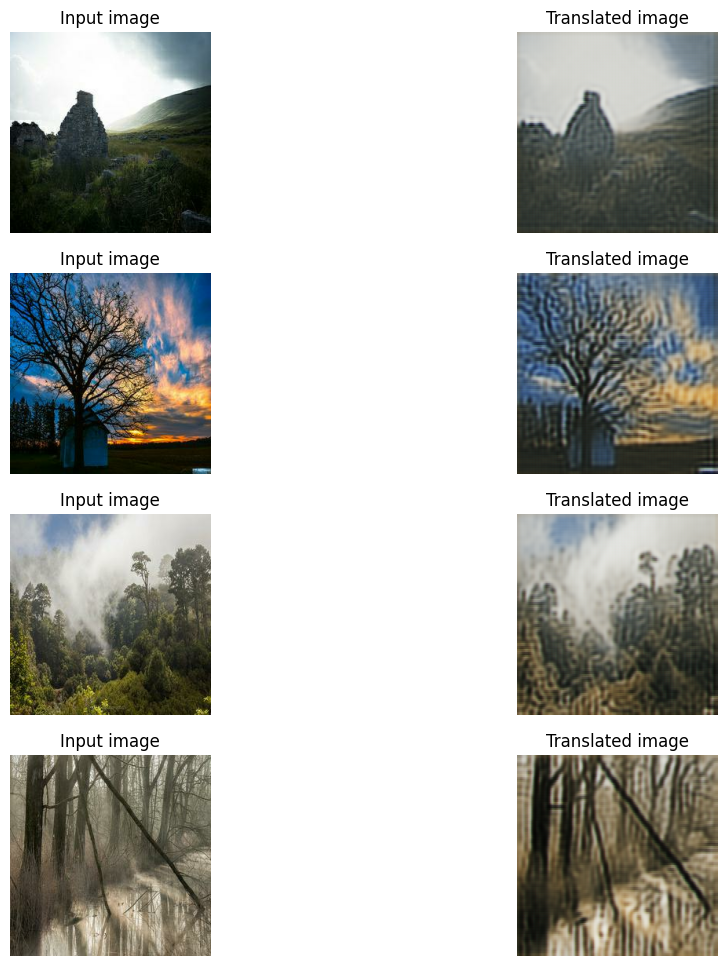

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 274ms/step - D_X_loss: 0.1300 - D_Y_loss: 0.1335 - F_loss: 3.0806 - G_loss: 3.1065
Epoch 9/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - D_X_loss: 0.1572 - D_Y_loss: 0.1526 - F_loss: 2.9523 - G_loss: 2.9746

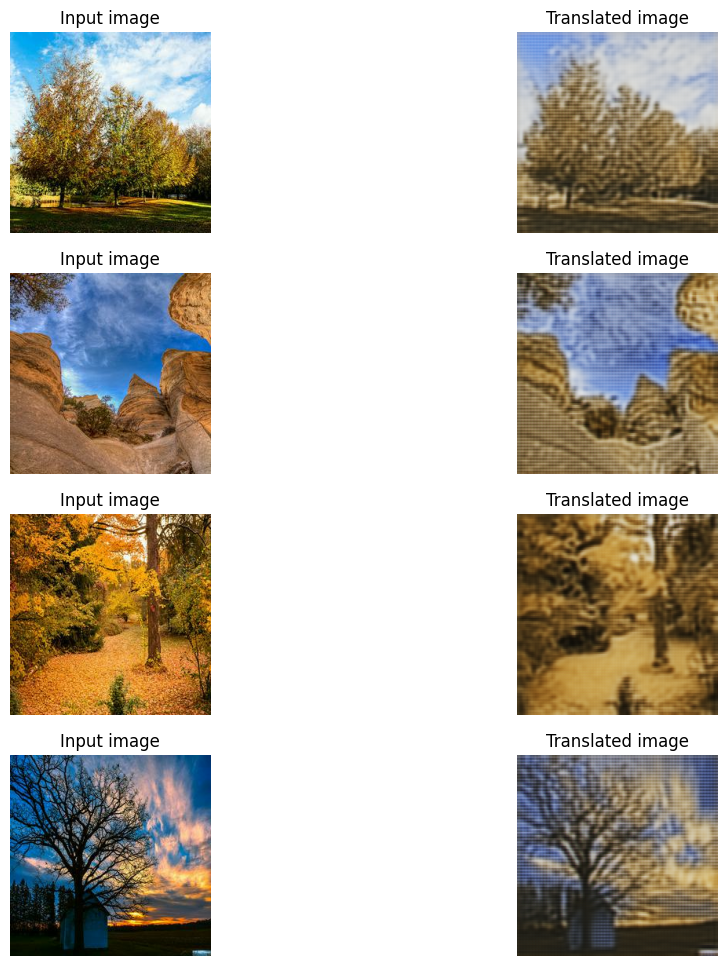

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 274ms/step - D_X_loss: 0.1580 - D_Y_loss: 0.1526 - F_loss: 2.9483 - G_loss: 2.9752
Epoch 10/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - D_X_loss: 0.0853 - D_Y_loss: 0.1380 - F_loss: 2.9395 - G_loss: 2.9089

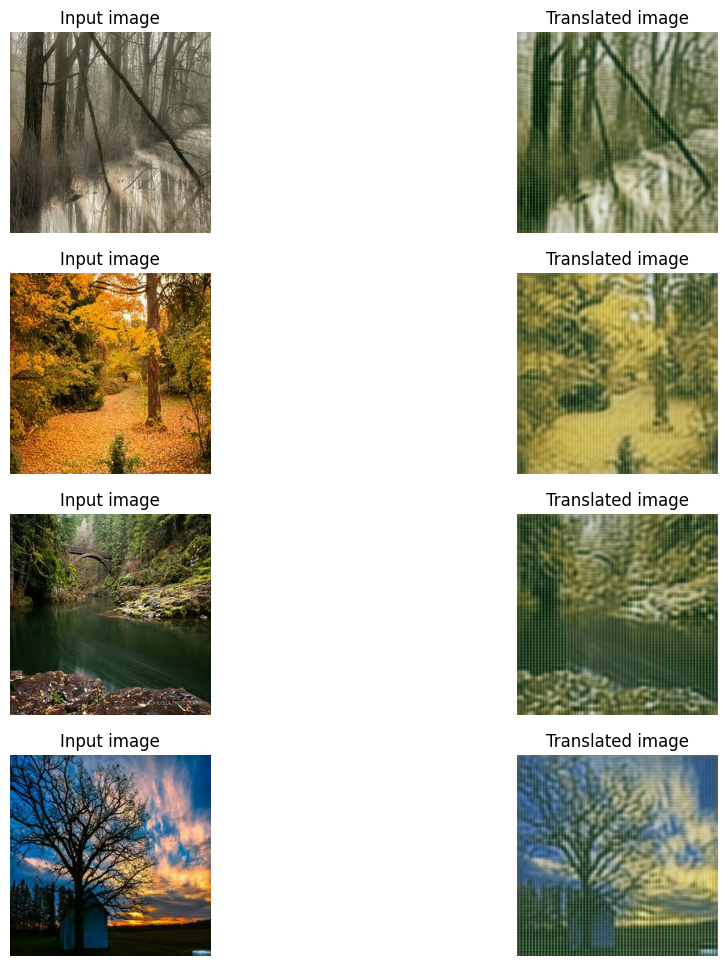

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 274ms/step - D_X_loss: 0.0850 - D_Y_loss: 0.1379 - F_loss: 2.9399 - G_loss: 2.9106
Epoch 11/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - D_X_loss: 0.1168 - D_Y_loss: 0.1504 - F_loss: 2.9267 - G_loss: 2.9127

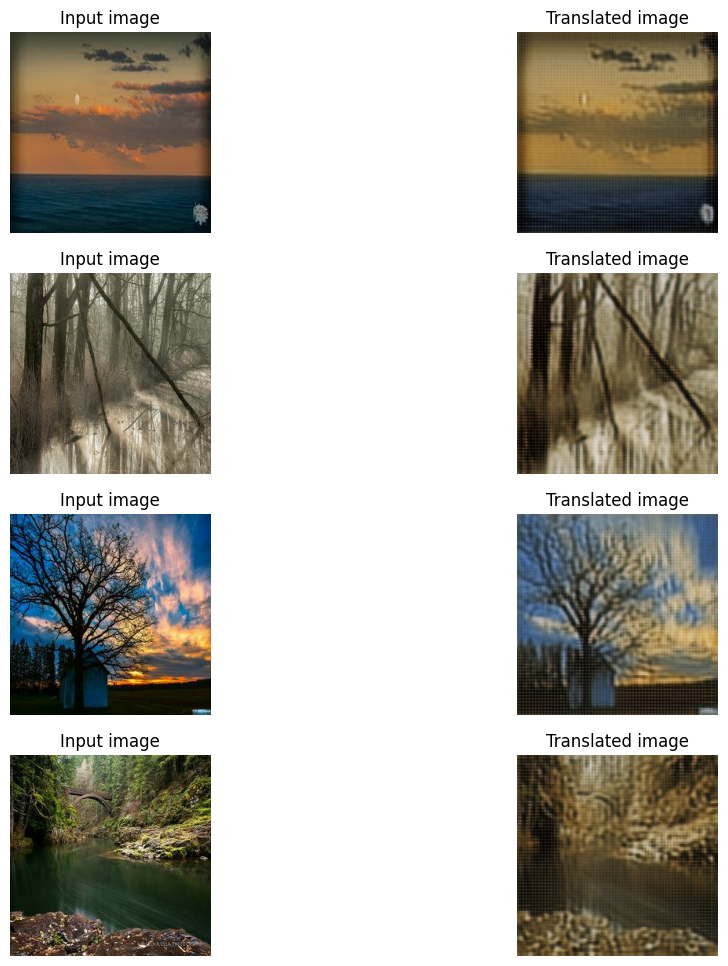

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 274ms/step - D_X_loss: 0.1177 - D_Y_loss: 0.1499 - F_loss: 2.9225 - G_loss: 2.9147
Epoch 12/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step - D_X_loss: 0.1567 - D_Y_loss: 0.1414 - F_loss: 2.7073 - G_loss: 2.9650

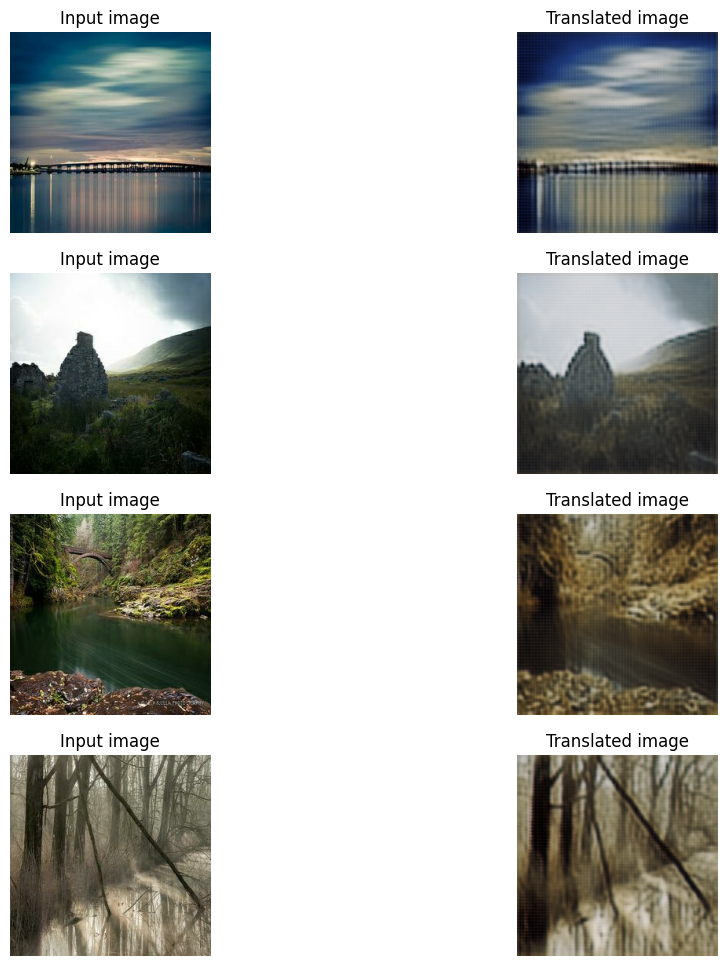

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 275ms/step - D_X_loss: 0.1571 - D_Y_loss: 0.1410 - F_loss: 2.7039 - G_loss: 2.9660
Epoch 13/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - D_X_loss: 0.1545 - D_Y_loss: 0.1290 - F_loss: 2.6915 - G_loss: 2.8721

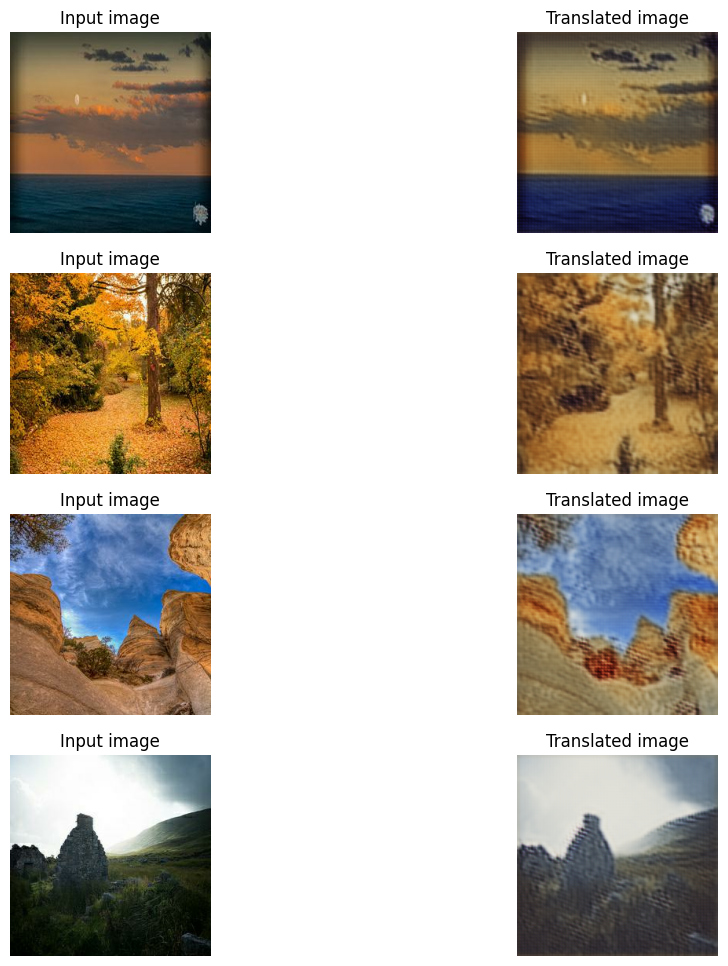

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 274ms/step - D_X_loss: 0.1542 - D_Y_loss: 0.1287 - F_loss: 2.6957 - G_loss: 2.8742
Epoch 14/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - D_X_loss: 0.1417 - D_Y_loss: 0.1310 - F_loss: 2.6964 - G_loss: 2.8584

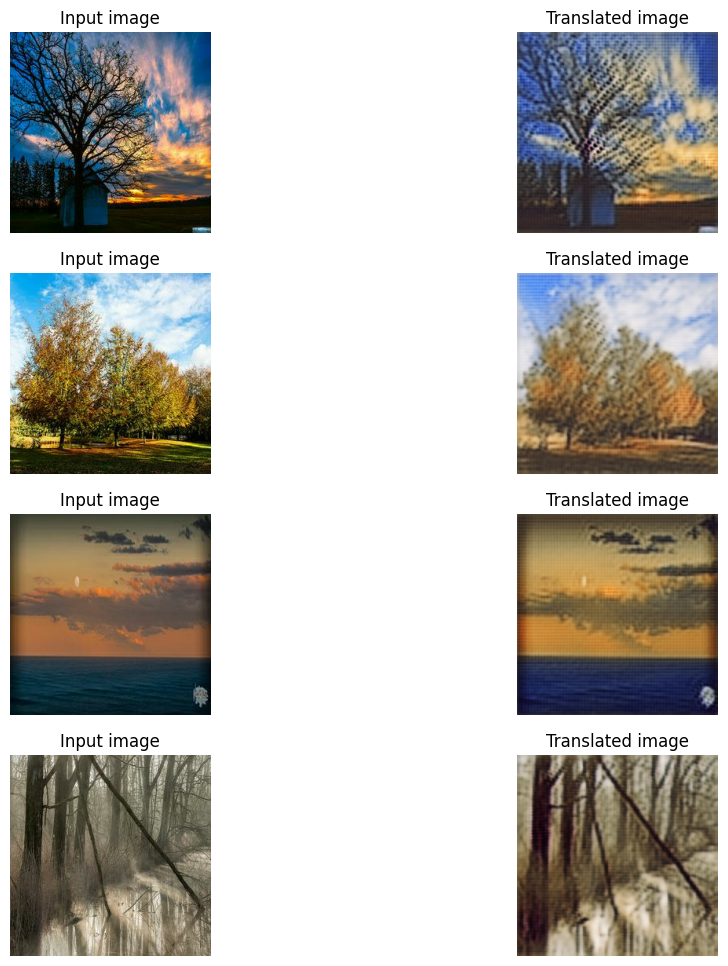

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 274ms/step - D_X_loss: 0.1413 - D_Y_loss: 0.1307 - F_loss: 2.7005 - G_loss: 2.8597
Epoch 15/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - D_X_loss: 0.1826 - D_Y_loss: 0.1489 - F_loss: 2.5941 - G_loss: 2.8042

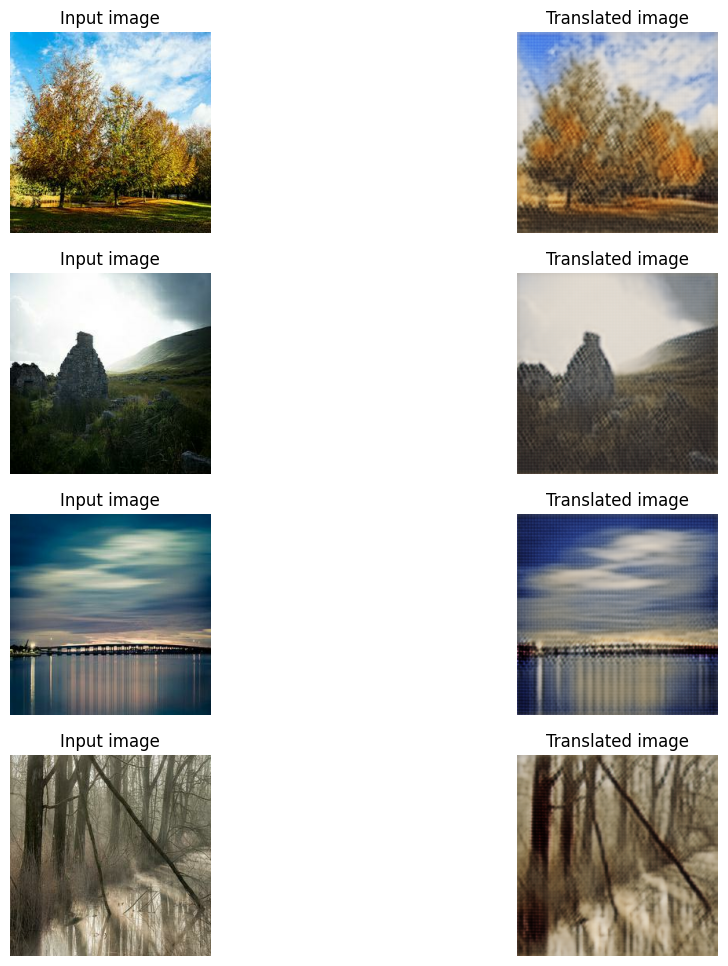

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 274ms/step - D_X_loss: 0.1830 - D_Y_loss: 0.1486 - F_loss: 2.5920 - G_loss: 2.8071
Epoch 16/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - D_X_loss: 0.1511 - D_Y_loss: 0.1164 - F_loss: 2.6006 - G_loss: 2.8503

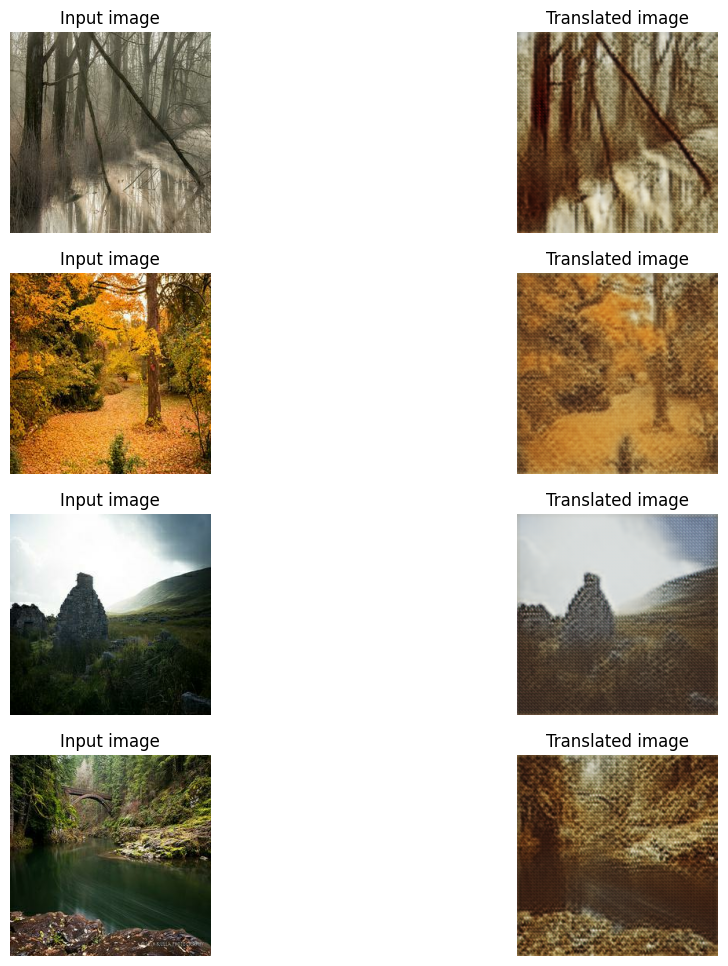

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 274ms/step - D_X_loss: 0.1508 - D_Y_loss: 0.1161 - F_loss: 2.6004 - G_loss: 2.8516
Epoch 17/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - D_X_loss: 0.1749 - D_Y_loss: 0.1813 - F_loss: 2.5573 - G_loss: 2.7381

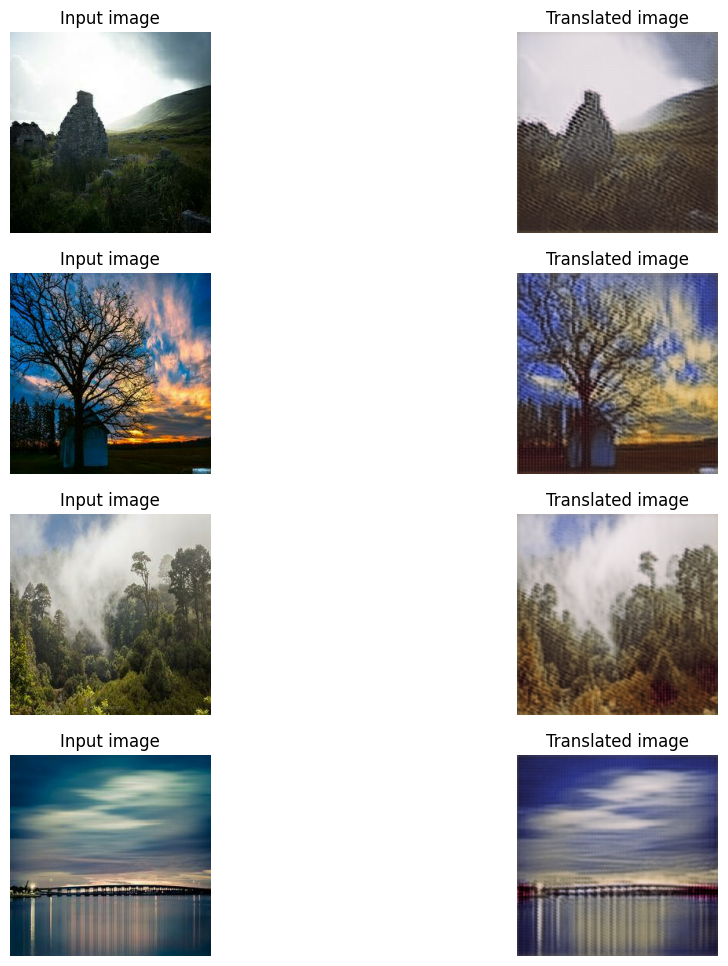

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 275ms/step - D_X_loss: 0.1745 - D_Y_loss: 0.1808 - F_loss: 2.5579 - G_loss: 2.7408
Epoch 18/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - D_X_loss: 0.1893 - D_Y_loss: 0.1765 - F_loss: 2.5083 - G_loss: 2.7154

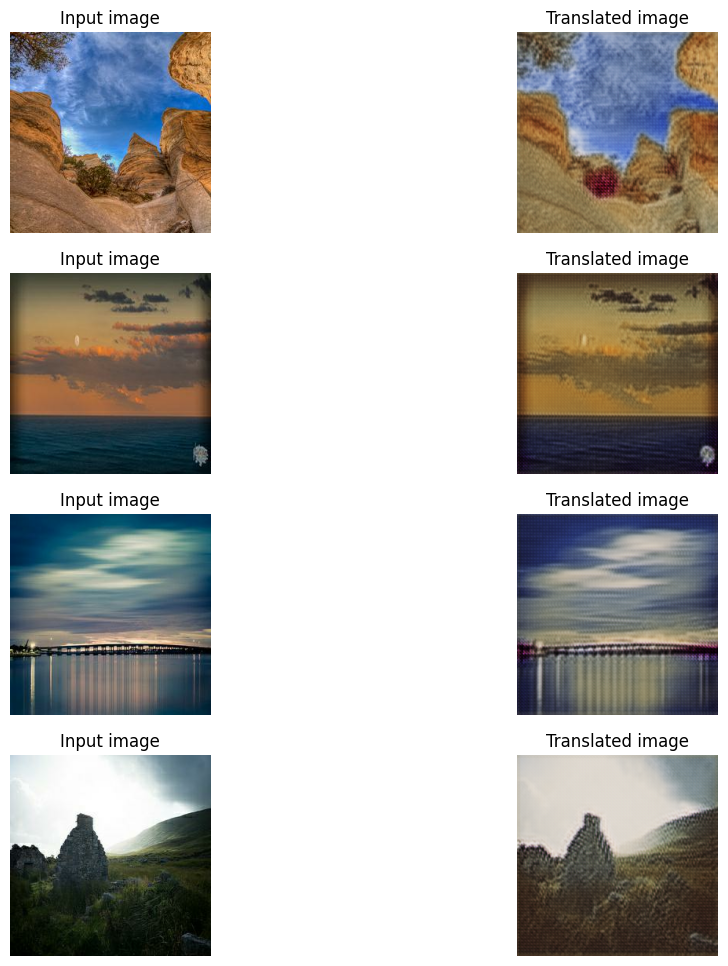

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 274ms/step - D_X_loss: 0.1890 - D_Y_loss: 0.1760 - F_loss: 2.5066 - G_loss: 2.7181
Epoch 19/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - D_X_loss: 0.1716 - D_Y_loss: 0.1605 - F_loss: 2.5161 - G_loss: 2.7529

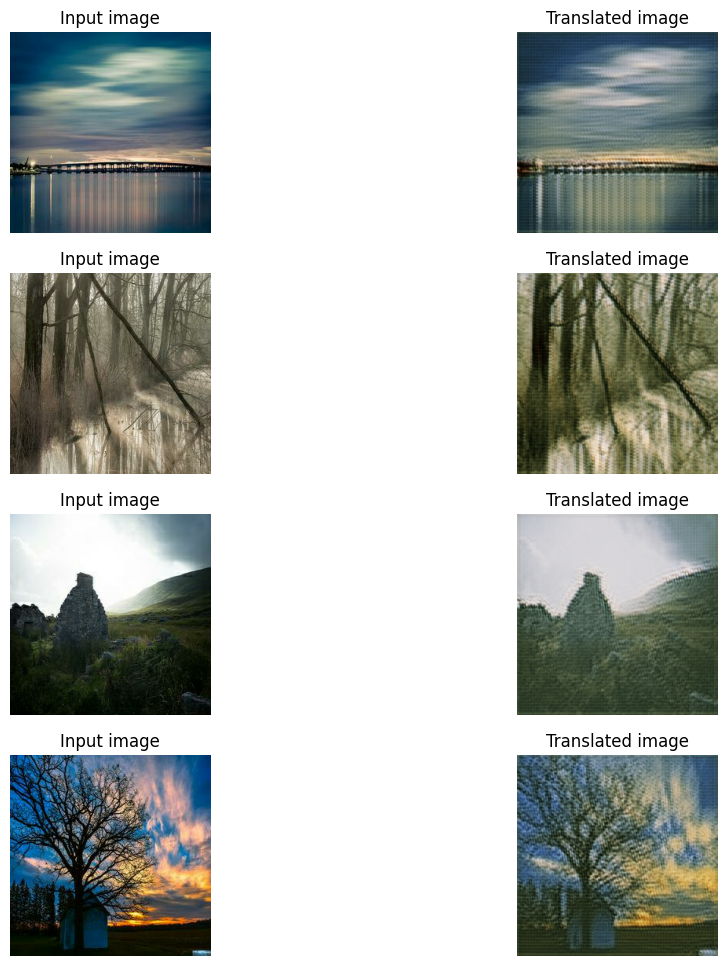

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 274ms/step - D_X_loss: 0.1716 - D_Y_loss: 0.1601 - F_loss: 2.5136 - G_loss: 2.7545
Epoch 20/20
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step - D_X_loss: 0.1775 - D_Y_loss: 0.1657 - F_loss: 2.4661 - G_loss: 2.7292

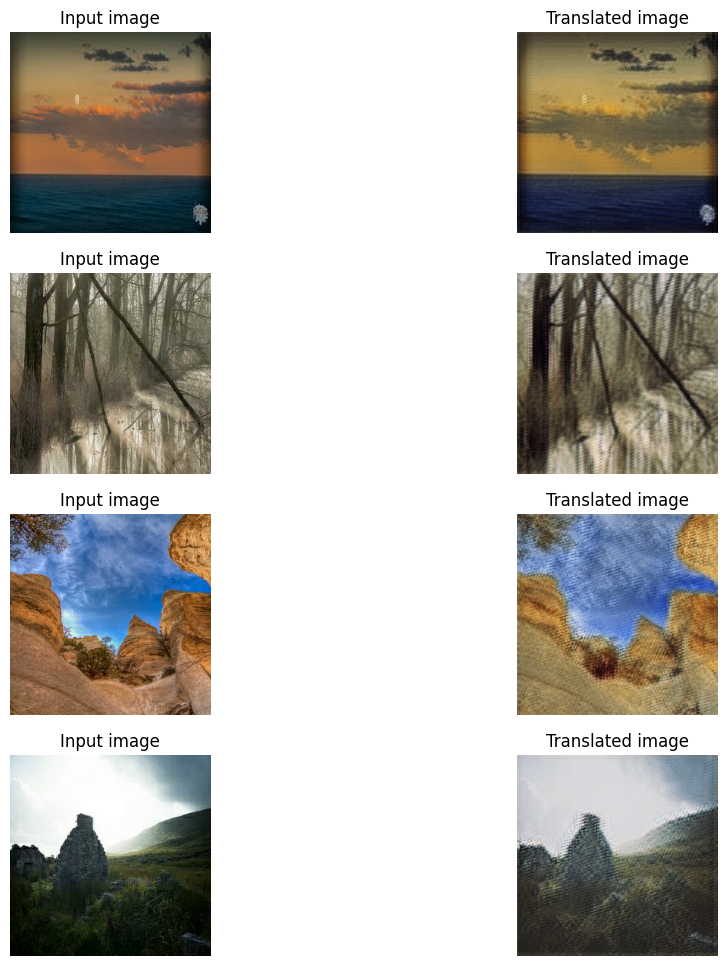

300/300 ━━━━━━━━━━━━━━━━━━━━ 82s 274ms/step - D_X_loss: 0.1771 - D_Y_loss: 0.1660 - F_loss: 2.4698 - G_loss: 2.7303


In [14]:
# Loss function for evaluating adversarial loss
adv_loss_fn = keras.losses.MeanSquaredError()

# Define the loss function for the generators


def generator_loss_fn(fake):
    fake_loss = adv_loss_fn(ops.ones_like(fake), fake)
    return fake_loss


# Define the loss function for the discriminators
def discriminator_loss_fn(real, fake):
    real_loss = adv_loss_fn(ops.ones_like(real), real)
    fake_loss = adv_loss_fn(ops.zeros_like(fake), fake)
    return (real_loss + fake_loss) * 0.5


# Create cycle gan model
cycle_gan_model = CycleGan(
    generator_G=gen_G, generator_F=gen_F, discriminator_X=disc_X, discriminator_Y=disc_Y
)

# Compile the model
cycle_gan_model.compile(
    gen_G_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_F_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)

# Explicitly build the model before training
# The input shape should match the shape of your images, e.g., (256, 256, 3)
# The 'None' dimension is for the batch size, which can be variable.
input_shape = (None, 256, 256, 3)
cycle_gan_model.build(input_shape=[input_shape, input_shape])


# Callbacks
plotter = GANMonitor()
checkpoint_filepath = "./model_checkpoints/cyclegan_checkpoints.weights.h5"
model_checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath, save_weights_only=True
)

# Here we will train the model for just one epoch as each epoch takes around
# 7 minutes on a single P100 backed machine.
cycle_gan_model.fit(
    tf.data.Dataset.zip((photo_ds, monet_ds)),
    epochs=20,
    callbacks=[plotter, model_checkpoint_callback],
)

### Test the performance of the model

Weights loaded successfully


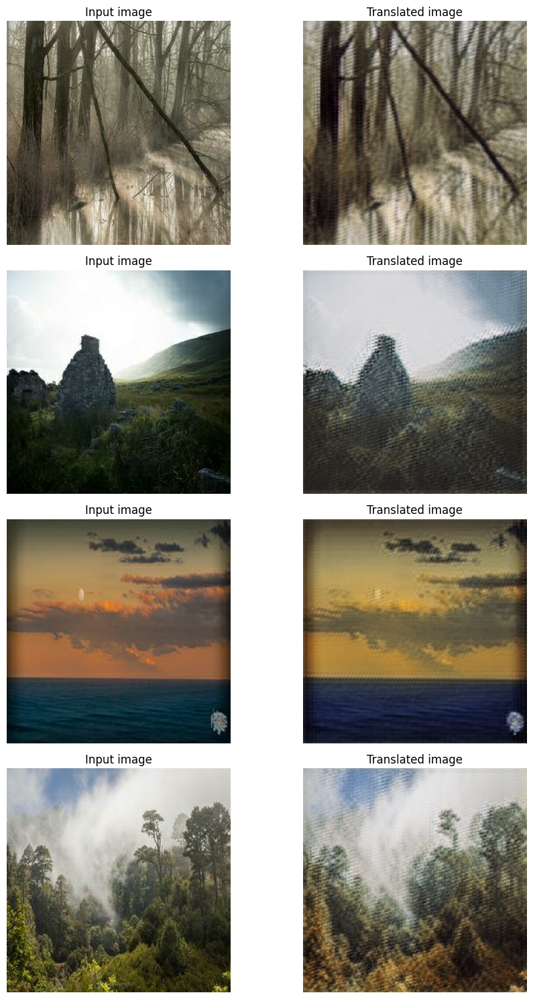

In [15]:
# Once the weights are loaded, we will take a few samples from the test data and check the model's performance.


# Load the checkpoints
cycle_gan_model.load_weights(checkpoint_filepath)
print("Weights loaded successfully")

_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, img in enumerate(photo_ds.take(4)):
    prediction = cycle_gan_model.gen_G(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img)
    ax[i, 1].imshow(prediction)
    ax[i, 0].set_title("Input image")
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")

    prediction = keras.utils.array_to_img(prediction)
    prediction.save("predicted_img_{i}.png".format(i=i))
plt.tight_layout()
plt.show()

<div style="background-color: magenta; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Results and Analysis

</div>

#### Conclusion

This project demonstrates the effectiveness of CycleGANs for unpaired image-to-image translation, specifically in transforming real-world photographs into Monet-style paintings. By leveraging adversarial, cycle-consistency, and identity losses, the model successfully learns to apply Monet's artistic style while preserving the content of the original photos. The results show convincing style transfer, capturing Monet's color palette and brush strokes. However, some limitations remain, such as occasional artifacts and imperfect style application, highlighting areas for further improvement. Overall, the CycleGAN approach provides a powerful tool for artistic domain adaptation and opens avenues for creative applications in image synthesis.


<div style="background-color: magenta; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Submission Generation

</div>

In [16]:
import PIL
! mkdir /kaggle/working/images_stage

In [17]:
import shutil
def create_submission():
    # shutil.rmtree('/kaggle/images/')
    for i, img in enumerate(photo_ds):
        prediction = cycle_gan_model.gen_G(img, training=False)[0].numpy()
        prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
        
        im = PIL.Image.fromarray(prediction)
        im.save("/kaggle/working/images_stage/" + str(i) + ".jpg")
    shutil.make_archive("/kaggle/working/images", 'zip', "/kaggle/working/images_stage")

In [18]:
create_submission()